In [2]:
import glob
import geopandas as gpd
import pandas as pd
import numpy as np
import rasterio
import sys
sys.path.append('/projects/Developer/icesat2_boreal/lib')
import maplib_folium

import matplotlib.pyplot as plt

plt.rcParams['figure.figsize'] = [25, 10]

/opt/conda/lib/python3.7/site-packages/geopandas/_compat.py:110: UserWarning: The Shapely GEOS version (3.8.0-CAPI-1.13.1 ) is incompatible with the GEOS version PyGEOS was compiled with (3.10.1-CAPI-1.16.0). Conversions between both will be slow.
  shapely_geos_version, geos_capi_version_string


223


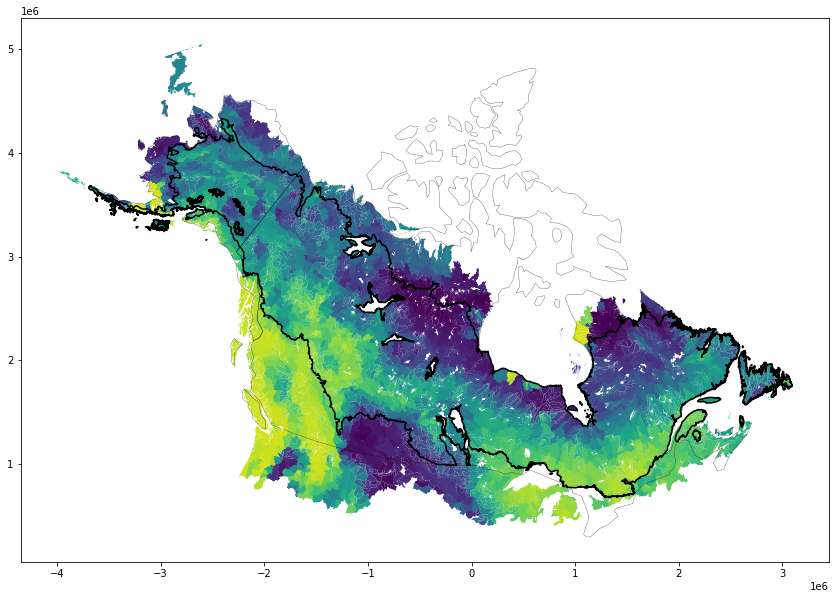

In [4]:
files = glob.glob('/projects/my-public-bucket/analyze_agb/output/zonal*.gpkg')
print(len(files))

z = pd.concat([gpd.read_file(f) for f in files])

above_domain_fn = '/projects/shared-buckets/lduncanson/data/above/ABoVE_Study_Domain.shp'
above_domain_gdf = gpd.read_file(above_domain_fn)#.cx[-180:-150, 50:75]

with rasterio.open('/projects/my-public-bucket/analyze_agb/AGB_tindex_america.vrt', mode='r') as src:
    raster_crs = src.crs
    
z.set_crs(raster_crs, allow_override=True, inplace=True)

world = gpd.read_file(gpd.datasets.get_path("naturalearth_lowres") )
alaska = world[world.name == 'United States of America'].explode().cx[-170:-50, 50:90]
canada = world[world.name == 'Canada']
canada_alaska = pd.concat([alaska, canada])
boreal_gdf = gpd.read_file('/projects/my-public-bucket/analyze_agb/input_zones/wwf_circumboreal_Dissolve.geojson')

ax = canada_alaska.cx[-170:-50,50:90].to_crs(above_domain_gdf.crs).boundary.plot(color='black', linewidth=0.25)
ax = boreal_gdf.cx[-180:-50,50:90].to_crs(above_domain_gdf.crs).boundary.plot(color='black', ax=ax)

z.to_crs(above_domain_gdf.crs).plot('total_Mg', cmap='viridis', legend=False, vmin=0, vmax=5000, ax=ax)


In [42]:
z.to_crs(above_domain_gdf.crs).plot('total_Mg', cmap='viridis', legend=False, vmin=0, vmax=2250, ax=ax)

<Figure size 1800x720 with 0 Axes>

In [47]:
z = z.replace('nan',np.nan)

In [69]:
z["mean"] = pd.to_numeric(z["mean"], errors='coerce')
z["median"] = pd.to_numeric(z["median"], errors='coerce')
z.info()
z[z["median"]>0]
z.dropna()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 9947 entries, 0 to 2
Data columns (total 25 columns):
 #   Column      Non-Null Count  Dtype   
---  ------      --------------  -----   
 0   HYBAS_ID    9947 non-null   int64   
 1   NEXT_DOWN   9947 non-null   int64   
 2   NEXT_SINK   9947 non-null   int64   
 3   MAIN_BAS    9947 non-null   int64   
 4   DIST_SINK   9947 non-null   float64 
 5   DIST_MAIN   9947 non-null   float64 
 6   SUB_AREA    9947 non-null   float64 
 7   UP_AREA     9947 non-null   float64 
 8   PFAF_ID     9947 non-null   int64   
 9   SIDE        9947 non-null   object  
 10  LAKE        9947 non-null   int64   
 11  ENDO        9947 non-null   int64   
 12  COAST       9947 non-null   int64   
 13  ORDER       9947 non-null   int64   
 14  SORT        9947 non-null   int64   
 15  area_sq_km  9947 non-null   float64 
 16  max         7953 non-null   object  
 17  mean        7953 non-null   float64 
 18  median      7953 non-null   float64 
 19  s

,HYBAS_ID,NEXT_DOWN,NEXT_SINK,MAIN_BAS,DIST_SINK,DIST_MAIN,SUB_AREA,UP_AREA,PFAF_ID,SIDE,...,area_sq_km,max,mean,median,std,min,sum,count,total_Mg,geometry
27,7070014530,0,7070014530,7070014530,0.0,0.0,8584.4,8584.4,7810070,M,...,8602.897759,645.872681,133.866409,119.181709,78.335432,5.064308,390249632.0,2915217,1487.404547,"MULTIPOLYGON (((3938111.807 2337889.808, 39376..."
28,7070014800,0,7070014800,7070014800,0.0,0.0,2216.2,2216.2,7810080,M,...,2221.569343,647.176147,120.308137,100.639191,73.527136,4.818119,295958016.0,2460000,1336.757073,"POLYGON ((3914744.119 2406344.142, 3914164.715..."
29,7070014810,0,7070014810,7070014810,0.0,0.0,1291.4,1291.4,7810090,M,...,1294.643103,624.451294,92.092654,74.491096,58.867679,5.062514,126373224.0,1372240,1023.251715,"MULTIPOLYGON (((3894534.270 2414708.981, 38940..."
30,7070014930,0,7070014930,7070014930,0.0,0.0,1299.9,651407.2,7821001,M,...,1303.201345,574.319641,101.556597,84.201523,61.983257,6.111014,138773840.0,1366468,1128.406633,"POLYGON ((3936744.557 2426917.593, 3936366.968..."
31,7070388180,7070383410,7070014930,7070014930,85.6,85.6,485.9,485.9,7821006,M,...,487.048255,565.121094,97.424668,81.407242,65.045259,5.563455,50628872.0,519672,1082.49631,"POLYGON ((3957374.033 2427437.350, 3956811.845..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3,8070007020,0,8070007020,8070007020,0.0,0.0,1248.6,30059.9,8132010,M,...,1257.252747,598.005798,36.844556,30.168098,28.048312,3.075953,49704448.0,1349031,409.383954,"POLYGON ((809653.644 3113960.758, 809590.775 3..."
4,8070007030,0,8070007030,8070007030,0.0,0.0,1867.7,1867.7,8133000,M,...,1880.548761,683.314148,36.171912,29.073082,28.319554,3.285594,70781560.0,1956810,401.910138,"MULTIPOLYGON (((780981.275 3116541.391, 781664..."
0,8070162560,8079000080,8070009560,8070009560,1401.1,1401.1,3801.7,26819.6,8222930,M,...,3826.975514,607.778992,25.847022,21.225119,19.136772,3.926654,96511720.0,3733959,287.189132,"POLYGON ((2449059.337 4076726.814, 2449157.497..."
1,8070176280,8079001730,8070009560,8070009560,1501.0,1501.0,6916.8,20675.2,8222950,M,...,6962.000339,673.093628,23.773308,19.574013,17.846094,3.745511,166360144.0,6997770,264.147871,"MULTIPOLYGON (((2479246.981 4016609.894, 24781..."


In [93]:
#maplib_folium.MAP_LAYER_FOLIUM(LAYER=z, LAYER_COL_NAME='median')

import folium
from folium import features
# https://autogis-site.readthedocs.io/en/latest/notebooks/L5/02_interactive-map-folium.html
# https://python-visualization.github.io/folium/quickstart.html

# Create a Map instance
m = folium.Map(location=[62, -150], tiles = 'cartodbpositron', zoom_start=5, control_scale=True)


LAYER_COL_NAME = 'median'
df_map = z[z[LAYER_COL_NAME]<500].dropna().sample(n=1000)

# Plot a choropleth map
# Notice: 'geoid' column that we created earlier needs to be assigned always as the first column
cp_layer = folium.Choropleth(
    geo_data=df_map,
    #name='AGB',
    data=df_map,
    columns=['HYBAS_ID',LAYER_COL_NAME],
    key_on='feature.properties.HYBAS_ID',
    fill_color='RdYlGn',
    fill_opacity=0.7,
    line_opacity=0.2,
    line_color='white', 
    line_weight=0,
    highlight=True, 
    smooth_factor=1.0,
    #bins=[1, 10, 50, 75, 100, 150],
    legend_name= 'Mg/ha')

cp_layer.add_to(m)

#https://stackoverflow.com/questions/70471888/text-as-tooltip-popup-or-labels-in-folium-choropleth-geojson-polygons
features.GeoJsonTooltip(
                fields=[LAYER_COL_NAME],
                aliases=[f'{LAYER_COL_NAME}:']
).add_to(cp_layer.geojson)


#Show map
m

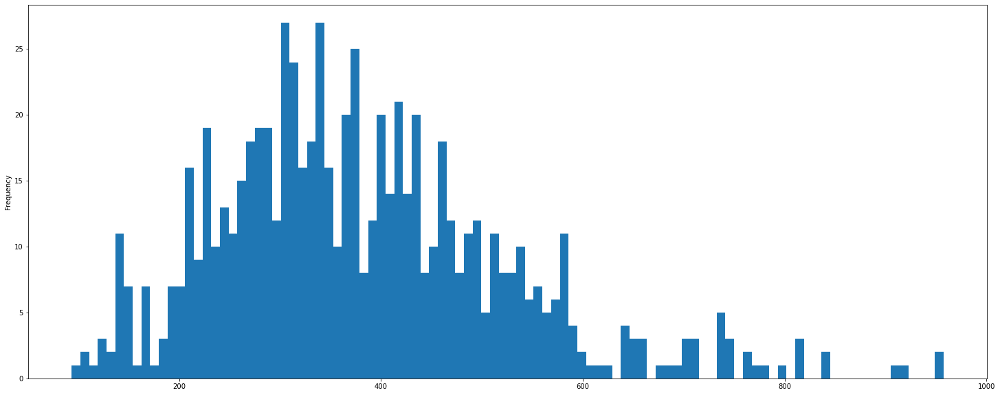

In [4]:
z[z.total_Mg < 1000].total_Mg.plot.hist(bins=100)